In [1]:
from math import ceil
from typing import Any, Dict, Literal, Tuple

import matplotlib.pyplot as plt
import numpy as np
import optuna
import pandas as pd
import polars as pl
import seaborn as sns
import sidetable
from catboost import CatBoostClassifier, Pool
from imblearn.combine import SMOTEENN
from imblearn.over_sampling import SMOTENC
from imblearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.metrics import (
    PrecisionRecallDisplay,
    RocCurveDisplay,
    classification_report,
    confusion_matrix,
    f1_score,
    precision_recall_curve,
    recall_score,
)
from sklearn.model_selection import RepeatedStratifiedKFold, train_test_split

# To run the pipeline put files `conv_predict_fields_description.csv` and `conv_predict_test_data.csv` in the same directory as this notebook.

In [2]:
def generate_features(df: pl.DataFrame) -> pl.DataFrame:
    """
    Generate new features from the existing columns in a Polars DataFrame.

    Parameters
    ----------
    df : pl.DataFrame
        The input Polars DataFrame containing columns such as:
        'sessions', 'sessions_length', 'spins_total', 'regular_spins', 'free_spins',
        'coins_start_day', 'coins_end_day', 'spend_coins', 'gems_start_day',
        'gems_end_day', 'spend_gems_slot', 'spend_gems_other', 'ups_start_day',
        'ups_end_day', 'spend_ups', 'hourly_bonus', 'daily_bonus',
        'points_start_day', 'points_end_day', 'jp_count', 'total_win_jp',
        'win_jp_bet', etc.

    Returns
    -------
    pl.DataFrame
        The original Polars DataFrame with additional generated feature columns.
    """

    df = df.with_columns(
        [
            # 1. Average session length (seconds per session)
            (pl.col("sessions_length") / pl.col("sessions")).alias(
                "avg_session_length"
            ),
            # 2. Ratio of free spins to total spins
            (pl.col("free_spins") / pl.col("spins_total")).alias(
                "ratio_free_spins"
            ),
            # 3. Net change in coins
            (pl.col("coins_end_day") - pl.col("coins_start_day")).alias("net_coins"),
            # 4. Total gems spent (slots + other)
            (pl.col("spend_gems_slot") + pl.col("spend_gems_other")).alias(
                "total_gems_spent"
            ),
            # 5. Net change in gems
            (pl.col("gems_end_day") - pl.col("gems_start_day")).alias("net_gems"),
            # 6. Net change in boosts (ups)
            (pl.col("ups_end_day") - pl.col("ups_start_day")).alias("net_ups"),
            # 7. Net jackpot coins
            (pl.col("total_win_jp") - pl.col("win_jp_bet")).alias("net_win_jp"),
            # 8. Spin success rate (fraction of spins that yielded any win)
            (pl.col("winning_spins") / pl.col("spins_total").fill_null(1)).alias(
                "spin_success_rate"
            ),
            # 9. Difference between regular spins and free spins
            (pl.col("regular_spins") - pl.col("free_spins")).alias("spins_diff"),
            # 10. Coins spent per session (if sessions > 0)
            (pl.col("spend_coins") / pl.col("sessions").fill_null(1)).alias(
                "spend_coins_per_session"
            ),
        ]
    )

    return df


def split_data(
    X: pd.DataFrame,
    y: pd.Series,
    val_size: float = 0.1,
    test_size: float = 0.1,
    random_state: int = 42,
    use_stratification: bool = False,
) -> Tuple[pd.DataFrame, pd.DataFrame, pd.DataFrame, pd.Series, pd.Series, pd.Series]:
    """
    Split input data into train, validation, and test sets, optionally using stratification.

    Parameters
    ----------
    X : pd.DataFrame
        Feature matrix.
    y : pd.Series
        Target variable.
    val_size : float, optional
        Proportion of the data to include in the validation set, by default 0.1.
    test_size : float, optional
        Proportion of the data to include in the test set, by default 0.1.
    random_state : int, optional
        Random seed for reproducible splits, by default 42.
    use_stratification : bool, optional
        If True, data splits will be stratified using the target variable. By default False.

    Returns
    -------
    Tuple[pd.DataFrame, pd.DataFrame, pd.DataFrame, pd.Series, pd.Series, pd.Series]
        A tuple containing:
        - X_train: pd.DataFrame
            Training feature matrix
        - X_val: pd.DataFrame
            Validation feature matrix
        - X_test: pd.DataFrame
            Test feature matrix
        - y_train: pd.Series
            Training target vector
        - y_val: pd.Series
            Validation target vector
        - y_test: pd.Series
            Test target vector

    Raises
    ------
    ValueError
        If the sum of val_size and test_size is greater than or equal to 1.
    """
    # Check that the requested splits are valid
    if val_size + test_size >= 1:
        raise ValueError("val_size + test_size must be less than 1.")

    # Determine stratification parameters
    stratify_test = y if use_stratification else None

    # First split off the test set
    X_temp, X_test, y_temp, y_test = train_test_split(
        X,
        y,
        test_size=test_size,
        random_state=random_state,
        stratify=stratify_test,  # stratify if specified
    )

    # Adjust val_size proportion relative to the remaining data after removing test
    adjusted_val_size = val_size / (1 - test_size)

    # For the second split (train/val), stratify on the reduced dataset if needed
    stratify_val = y_temp if use_stratification else None

    # Split the remaining data into train and validation
    X_train, X_val, y_train, y_val = train_test_split(
        X_temp,
        y_temp,
        test_size=adjusted_val_size,
        random_state=random_state,
        stratify=stratify_val,  # stratify if specified
    )

    return X_train, X_val, X_test, y_train, y_val, y_test

In [3]:
fields_descriprion = pl.read_csv("conv_predict_fields_description.csv")
df = pl.read_csv(
    "conv_predict_test_data.csv",
    separator=";",  # Custom delimiter
    infer_schema_length=10000,  # Adjust if the data set is large
    try_parse_dates=True,  # Automatically parse date columns
)

In [4]:
fields_descriprion

progress_id;Unique user identifier in the app
str
"""action_date;Date when the user…"
"""entry_date;Date when the user …"
"""sessions;Number of user sessio…"
"""sessions_length;Total session …"
"""level;Level"""
…
"""bg_count;Number of bonus games"""
"""fs_count;Number of free spin g…"
"""freespins;Number of free spins"""


In [5]:
df.head(10)

�progress_id,action_date,entry_date,sessions,sessions_length,level,spins_total,regular_spins,free_spins,coins_start_day,coins_end_day,spend_coins,gems_start_day,gems_end_day,spend_gems_slot,spend_gems_other,ups_start_day,ups_end_day,spend_ups,hourly_bonus,daily_bonus,status_points_end_day,country_install,source,total_win_bg,total_win_fs,total_win,max_bet,total_win_jp,cashback_spins,win_jp_bet,jp_fix_mult,win_spins,win_bet_spins,win_bet_bg,win_bet_fs,winning_spins,jp_count,bg_count,fs_count,freespins,sum_coins,is_first_payment
str,"datetime[μs, UTC]","datetime[μs, UTC]",i64,i64,i64,i64,i64,i64,f64,f64,f64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,str,i64,f64,f64,f64,f64,f64,f64,f64,i64,f64,f64,f64,f64,i64,i64,i64,i64,i64,i64,bool
"""5996422dd72a657f8382c0668af""",2023-04-01 00:00:00 UTC,2023-03-28 00:00:00 UTC,23,36186,129,10225,8118,2107,3.2296e9,2.65536553e8,5.8735e10,158,35,1,186,0,7,15,25,1,248,"""US""",12,1.4252e10,1.1036e10,5.1122e10,5e8,3.7417e9,1161.5,1096.900279,0,2.2091e10,3059.92,2600.1,1258.02,2992,40,226,41,2098,327166143,false
"""343641c68435d3b9631c8034dd0""",2023-03-24 00:00:00 UTC,2023-03-23 00:00:00 UTC,14,46587,118,14302,11571,2731,8.5648e9,7.8019e9,2.3600e11,176,258,110,0,82,159,0,3,0,240,"""US""",8,6.5655e10,3.5489e10,2.1700e11,5e8,3.4979e10,1280.16,1112.500135,0,8.0599e10,4686.713333,2189.0,2181.28,4257,27,218,75,2651,1362951001,false
"""489641c8ceb220f936e2f0559b9""",2023-03-29 00:00:00 UTC,2023-03-23 00:00:00 UTC,14,71621,49,9535,8843,692,4.297735e8,3.81960197e8,6.891e8,228,228,0,0,71,71,0,0,0,88,"""US""",0,1.42217697e8,2.67025e8,6.39618697e8,200000.0,0.0,16.26,0.0,0,2.30376e8,2972.25,1829.410104,3346.475,2251,0,164,86,691,3600000,false
"""07564228751e8fb6662500657c1""",2023-03-29 00:00:00 UTC,2023-03-28 00:00:00 UTC,16,31728,117,20608,17915,2693,1.3829e9,2.1166e9,4.9486e10,199,10,230,0,141,4,216,3,0,224,"""CA""",8,6.9474e9,8.6186e9,3.9929e10,5e8,1.4701e9,535.11,340.100018,0,2.2893e10,8884.85,3148.050113,2917.19,5991,14,154,132,2441,312808483,false
"""1466421c6dbda72929aa70a6e15""",2023-03-30 00:00:00 UTC,2023-03-27 00:00:00 UTC,20,70102,69,9127,8464,663,1.8415e9,1.56468637e8,9.8121e9,248,249,0,0,104,105,0,9,1,128,"""US""",8,1.9724e9,2.7492e9,7.9581e9,4e6,0.0,13.11,0.0,0,3.2364e9,2716.8,1817.79001,2460.75,2131,0,152,84,663,25186416,false
"""347641f03c1ef201bff410ed7e5""",2023-03-29 00:00:00 UTC,2023-03-25 00:00:00 UTC,21,31335,105,13138,11260,1878,1.0327e9,1.4700921e7,5.3073e10,2,15,106,0,111,165,0,11,1,200,"""CH""",0,5.4644e9,9.1837e9,4.0654e10,5e8,1.1045e7,74.94,26.251168,0,2.5995e10,5353.855,2104.689091,2465.97,3572,2,151,97,1627,703326872,false
"""22664219528003d8697f6097ca3""",2023-03-28 00:00:00 UTC,2023-03-27 00:00:00 UTC,27,59231,127,14173,11430,2743,2.5611e9,1.5115e10,1.3100e11,10,34,176,0,91,161,0,0,0,244,"""MX""",5,3.1289e10,2.9034e10,1.2000e11,5e8,5.2928e9,415.42,203.550003,0,5.4401e10,5386.45,1975.75,2937.07,3965,13,149,115,2453,1349800000,false
"""472641c03eabe29d589d804f33e""",2023-03-24 00:00:00 UTC,2023-03-23 00:00:00 UTC,22,20575,115,7862,5817,2045,55599.0,25503.0,6.0247e10,23,5,116,30,107,166,0,7,1,220,"""SA""",0,6.7635e9,5.2158e9,4.5105e10,5e8,3.8146e9,454.0,406.243974,0,2.9311e10,3214.09,1597.614384,1249.765,2000,22,149,45,1925,800525578,false
"""570641a18fe7656467d990cbc2a""",2023-03-22 00:00:00 UTC,2023-03-21 00:00:00 UTC,28,63471,149,20667,18150,2517,1.74525e8,3.9260e10,3.2900e11,0,183,140,0,68,190,0,3,0,288,"""MX""",5,3.4750e10,1.0400e11,3.2800e11,5e8,9.7349e9,278.52,293.457824,0,1.8000e11,10518.32,2545.77073,3391.344995,6449,17,148,166,2358,2082578116,false


In [6]:
df.shape

(165508, 43)

In [7]:
df = df.rename({"�progress_id": "progress_id"})

EDA

In [8]:
df = generate_features(df)

In [9]:
df.select("progress_id").n_unique()

98739

In [10]:
df.schema

Schema([('progress_id', String),
        ('action_date', Datetime(time_unit='us', time_zone='UTC')),
        ('entry_date', Datetime(time_unit='us', time_zone='UTC')),
        ('sessions', Int64),
        ('sessions_length', Int64),
        ('level', Int64),
        ('spins_total', Int64),
        ('regular_spins', Int64),
        ('free_spins', Int64),
        ('coins_start_day', Float64),
        ('coins_end_day', Float64),
        ('spend_coins', Float64),
        ('gems_start_day', Int64),
        ('gems_end_day', Int64),
        ('spend_gems_slot', Int64),
        ('spend_gems_other', Int64),
        ('ups_start_day', Int64),
        ('ups_end_day', Int64),
        ('spend_ups', Int64),
        ('hourly_bonus', Int64),
        ('daily_bonus', Int64),
        ('status_points_end_day', Int64),
        ('country_install', String),
        ('source', Int64),
        ('total_win_bg', Float64),
        ('total_win_fs', Float64),
        ('total_win', Float64),
        ('max_bet', Float6

In [11]:
(df.select("is_first_payment").group_by("is_first_payment").len())

is_first_payment,len
bool,u32
false,163783
true,1725


Missing values

In [12]:
missing_df = (
    df.select(pl.all().exclude("progress_id", "is_first_payment"))
    .null_count()
    .transpose(include_header=True)
    .rename({"column_0": "Null Values"})
    .with_columns((pl.col("Null Values") / df.shape[0] * 100).alias("Null%"))
    .sort("Null Values", descending=True)
)

missing_df

column,Null Values,Null%
str,u32,f64
"""sum_coins""",34766,21.005631
"""total_win_bg""",26581,16.060251
"""total_win_fs""",26581,16.060251
"""total_win""",26581,16.060251
"""max_bet""",26581,16.060251
…,…,…
"""total_gems_spent""",0,0.0
"""net_gems""",0,0.0
"""net_ups""",0,0.0


A lot of missing values in a few cols and they have the same amount of missing values. It is possible that they are missing in the same rows.

In [13]:
df.filter(pl.col("total_win_bg").is_null())

progress_id,action_date,entry_date,sessions,sessions_length,level,spins_total,regular_spins,free_spins,coins_start_day,coins_end_day,spend_coins,gems_start_day,gems_end_day,spend_gems_slot,spend_gems_other,ups_start_day,ups_end_day,spend_ups,hourly_bonus,daily_bonus,status_points_end_day,country_install,source,total_win_bg,total_win_fs,total_win,max_bet,total_win_jp,cashback_spins,win_jp_bet,jp_fix_mult,win_spins,win_bet_spins,win_bet_bg,win_bet_fs,winning_spins,jp_count,bg_count,fs_count,freespins,sum_coins,is_first_payment,avg_session_length,ratio_free_spins,net_coins,total_gems_spent,net_gems,net_ups,net_win_jp,spin_success_rate,spins_diff,spend_coins_per_session
str,"datetime[μs, UTC]","datetime[μs, UTC]",i64,i64,i64,i64,i64,i64,f64,f64,f64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,str,i64,f64,f64,f64,f64,f64,f64,f64,i64,f64,f64,f64,f64,i64,i64,i64,i64,i64,i64,bool,f64,f64,f64,i64,i64,i64,f64,f64,i64,f64
"""000641b5d732c174fd4a5033b3b""",2023-03-22 00:00:00 UTC,2023-03-22 00:00:00 UTC,1,9,0,0,0,0,1.2e7,1.2e7,0.0,50,50,0,0,10,10,0,0,0,0,"""US""",0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,9.0,NaN,0.0,0,0,0,null,null,0,0.0
"""950641e281f3f06500f6e0f1c51""",2023-03-30 00:00:00 UTC,2023-03-24 00:00:00 UTC,1,0,29,0,0,0,31378.0,31378.0,0.0,5,5,0,0,61,61,0,0,0,48,"""AR""",0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,0.0,NaN,0.0,0,0,0,null,null,0,0.0
"""341641695d4f25496ab7106aeb1""",2023-03-19 00:00:00 UTC,2023-03-19 00:00:00 UTC,1,25,0,0,0,0,1.2e7,1.2e7,0.0,50,50,0,0,10,10,0,0,0,0,"""US""",0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,25.0,NaN,0.0,0,0,0,null,null,0,0.0
"""15864211b5098a40309520bafd6""",2023-04-01 00:00:00 UTC,2023-03-27 00:00:00 UTC,1,598,1,0,0,0,1.3234e7,1.3234e7,0.0,80,80,0,0,20,20,0,0,0,1,"""US""",0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,598.0,NaN,0.0,0,0,0,null,null,0,0.0
"""4186424a8a45b9378284706d31c""",2023-03-29 00:00:00 UTC,2023-03-29 00:00:00 UTC,1,267,0,0,0,0,1.2e7,1.2e7,0.0,50,50,0,0,10,10,0,0,0,0,"""US""",0,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,267.0,NaN,0.0,0,0,0,null,null,0,0.0
…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…,…
"""88564270b803905912fb602e713""",2023-03-31 00:00:00 UTC,2023-03-31 00:00:00 UTC,5,134,0,0,0,0,1.2e7,1.2e7,0.0,50,50,0,0,10,10,0,0,0,0,"""US""",3,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,26.8,NaN,0.0,0,0,0,null,null,0,0.0
"""722642054c298f951a79e01dd52""",2023-03-28 00:00:00 UTC,2023-03-26 00:00:00 UTC,1,1,21,0,0,0,2.8978772e7,2.8978772e7,0.0,115,115,0,0,49,49,0,0,0,32,"""CA""",7,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,false,1.0,NaN,0.0,0,0,0,null,null,0,0.0
"""511641b70813d65d3765f08ee17""",2023-03-28 00:00:00 UTC,2023-03-22 00:00:00 UTC,2,74,23,0,0,0,1.38185e7,1.56185e7,0.0,129,129,0,0,55,55,0,0,0,36,"""US""",16,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,1800000,false,37.0,NaN,1.8e6,0,0,0,null,null,0,0.0


In [14]:
(
    df.filter(pl.col("total_win_bg").is_null())
    .select("is_first_payment")
    .group_by("is_first_payment")
    .len()
)

is_first_payment,len
bool,u32
false,26474
true,107


In [15]:
(
    df.filter(pl.col("total_win_bg").is_null())
    .select(
        pl.n_unique(
            "sessions",
            "spins_total",
            "regular_spins",
            "spend_coins",
            "spend_gems_slot",
            "spend_gems_other",
            "spend_ups",
            "hourly_bonus",
        )
    )
    .transpose(include_header=True)
)

column,column_0
str,u32
"""sessions""",47
"""spins_total""",1011
"""regular_spins""",928
"""spend_coins""",1921
"""spend_gems_slot""",169
"""spend_gems_other""",100
"""spend_ups""",105
"""hourly_bonus""",22


In [16]:
def select_top_correlated_features(
    data: pd.DataFrame, target_col: str, n_features: int = 5
) -> list[str]:
    """
    Select top n_features most correlated with a given target column.

    Parameters
    ----------
    data : pd.DataFrame
        The input DataFrame containing all features and target.
    target_col : str
        The name of the target column in the DataFrame.
    n_features : int, optional
        Number of top correlated features to return, by default 5.

    Returns
    -------
    List[str]
        A list of feature names that have the highest correlation
        with the target variable.

    Raises
    ------
    ValueError
        If target_col is not found in the DataFrame.
    """
    if target_col not in data.columns:
        raise ValueError(f"Target column '{target_col}' not found in DataFrame.")

    # Calculate correlation coefficients of each feature with the target
    correlations = data.corr()[target_col].abs().sort_values(ascending=False)

    # Exclude the target column itself and pick the top n_features
    top_features = (
        correlations.drop(labels=[target_col]).head(n_features).index.tolist()
    )

    return top_features


def create_pairplots_in_chunks(
    data: pd.DataFrame, feature_cols: list[str], chunk_size: int = 5, hue: str = None
) -> None:
    """
    Create seaborn pairplots for subsets of features.

    Parameters
    ----------
    data : pd.DataFrame
        The input DataFrame containing all features.
    feature_cols : List[str]
        List of columns (features) to include in the pairplots.
    chunk_size : int, optional
        Number of features to include in each chunk, by default 5.
    hue : str, optional
        Column name for color encoding in the pairplot, by default None.

    Returns
    -------
    None
        Displays one or more seaborn pairplots.
    """
    # Number of chunks needed to cover all features
    n_chunks = ceil(len(feature_cols) / chunk_size)

    for i in range(n_chunks):
        start = i * chunk_size
        end = (i + 1) * chunk_size
        subset_cols = feature_cols[start:end]

        # Pairplot for this chunk of features
        sns.pairplot(
            data=data[subset_cols + ([hue] if hue else [])], hue=hue, corner=True
        )
        plt.suptitle(f"Pairplot for features {subset_cols}", y=1.02, fontsize=14)
        plt.show()

In [17]:
to_exclude = [
    "progress_id",
    "action_date",
    "entry_date",
    "country_install"
]

df_pandas = df.select(pl.all().exclude(to_exclude)).to_pandas().sample(10000)

In [18]:
df_pandas.shape

(10000, 49)

Top correlated features: ['hourly_bonus', 'spend_ups', 'win_bet_bg', 'win_bet_fs', 'spins_total', 'regular_spins', 'total_win_fs', 'winning_spins', 'spins_diff', 'free_spins', 'daily_bonus', 'fs_count', 'bg_count', 'total_win_bg', 'win_bet_spins', 'freespins', 'sessions', 'spend_gems_slot', 'sessions_length', 'jp_count']


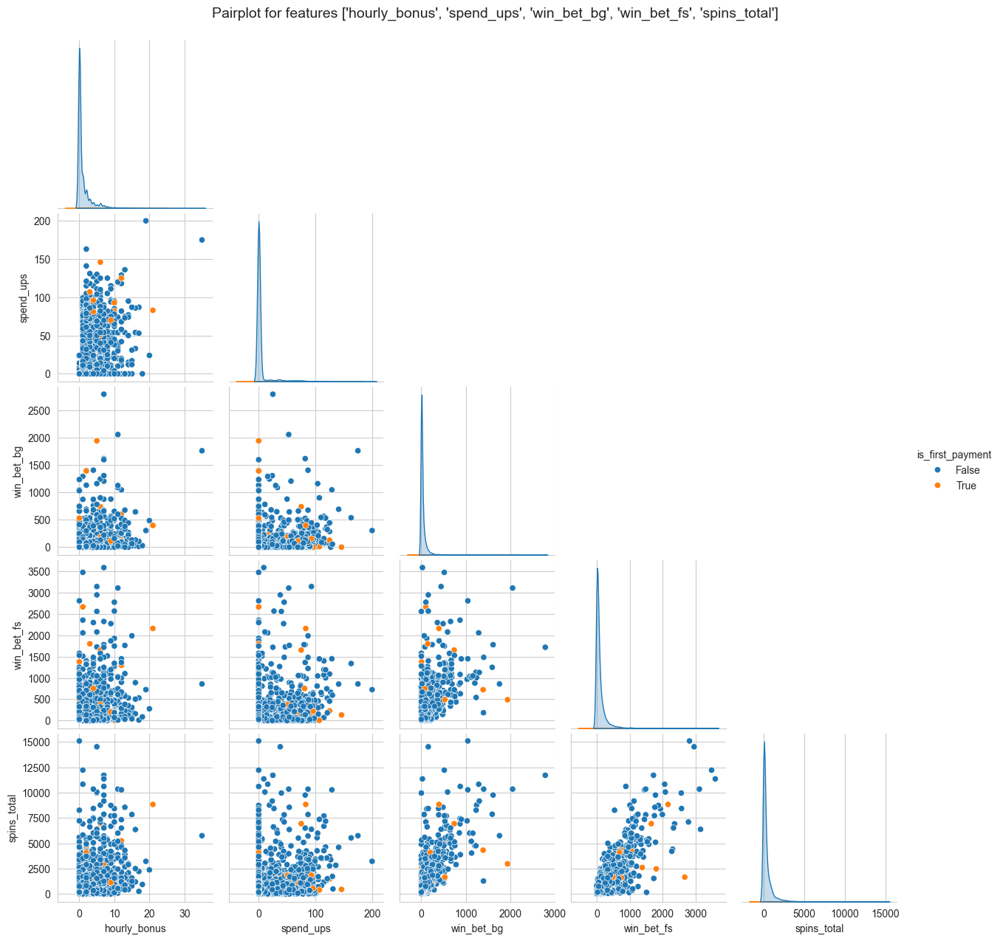

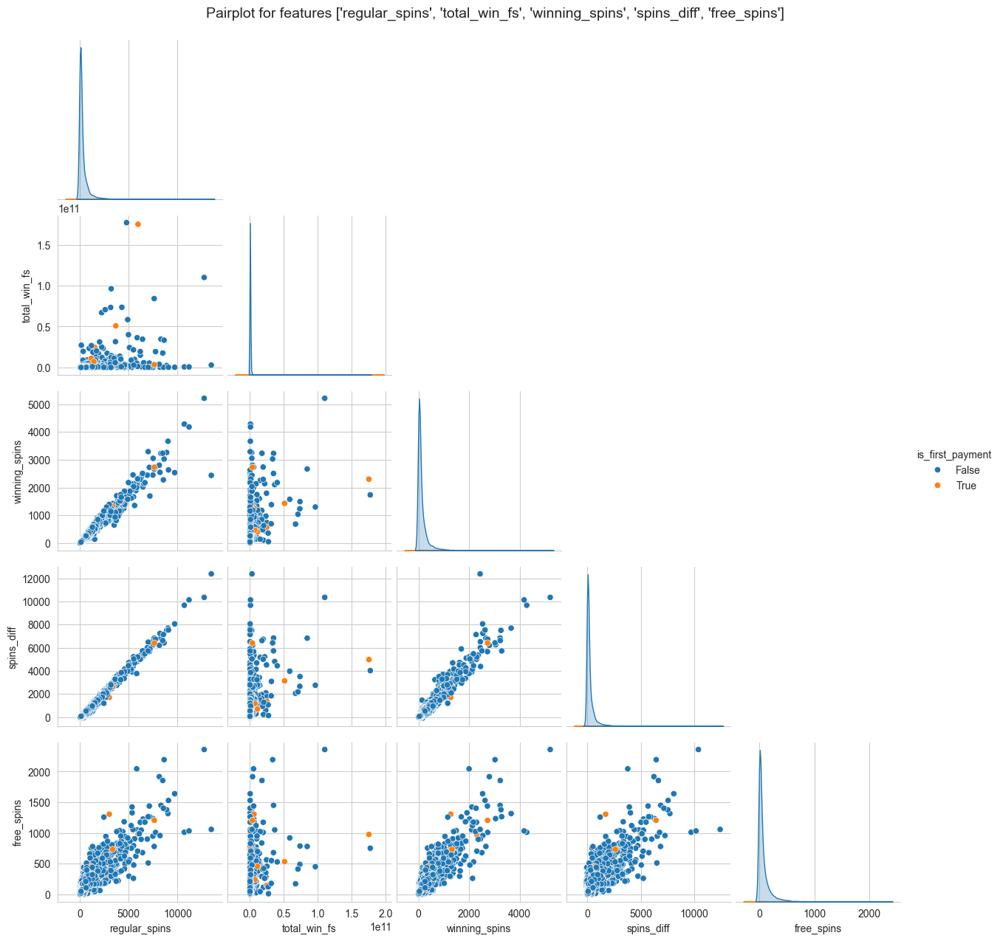

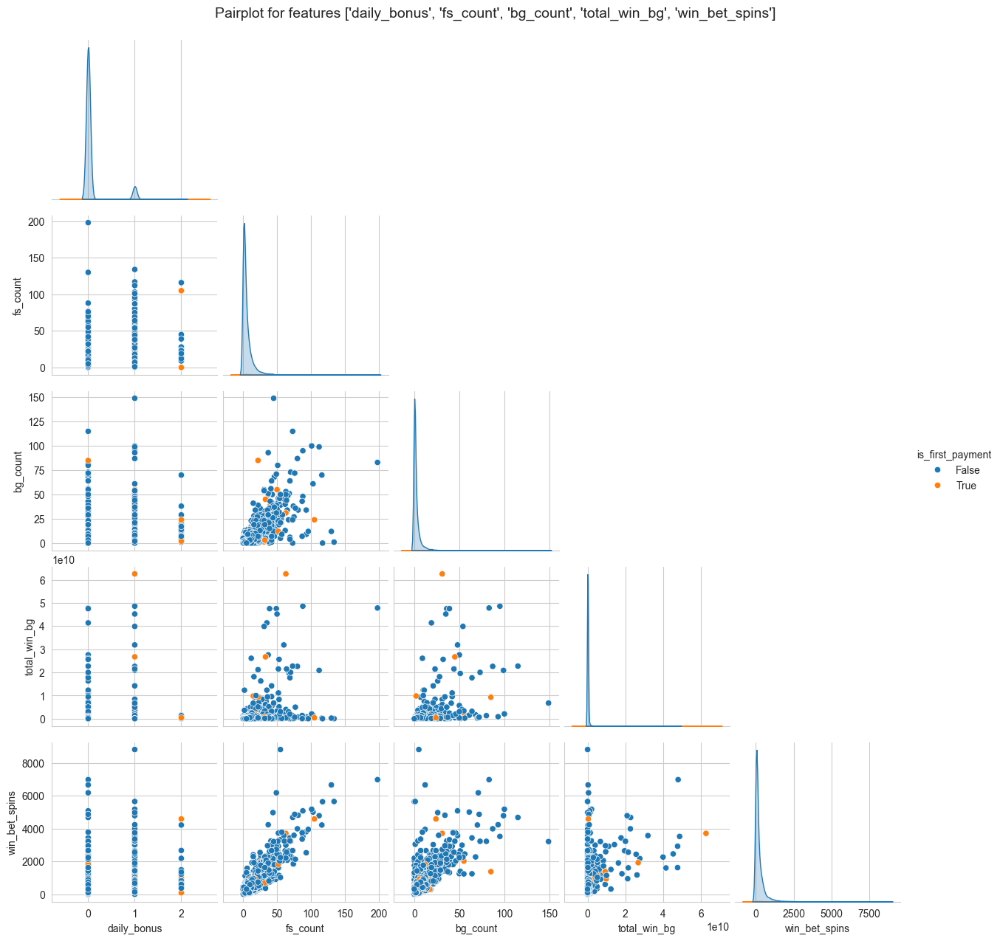

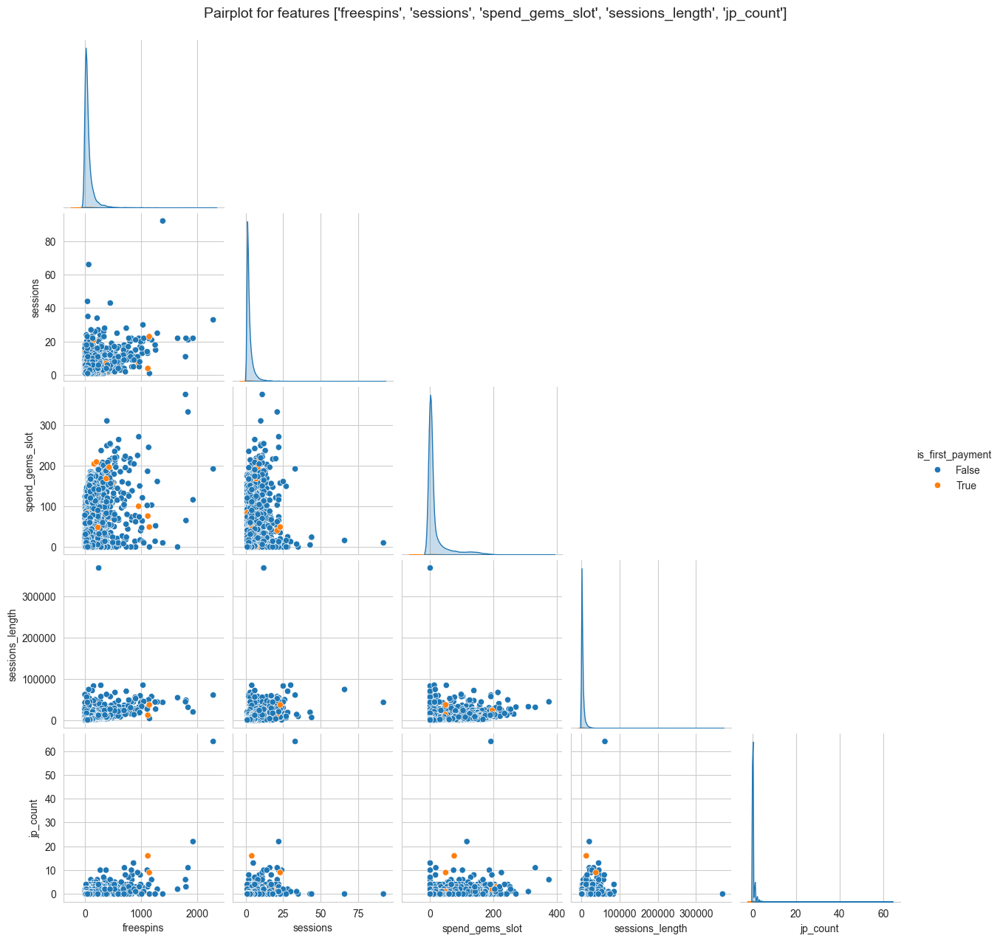

In [19]:
top_features = select_top_correlated_features(
    df_pandas, target_col="is_first_payment", n_features=20
)
print("Top correlated features:", top_features)

create_pairplots_in_chunks(
    df_pandas, feature_cols=top_features, chunk_size=5, hue="is_first_payment"
)

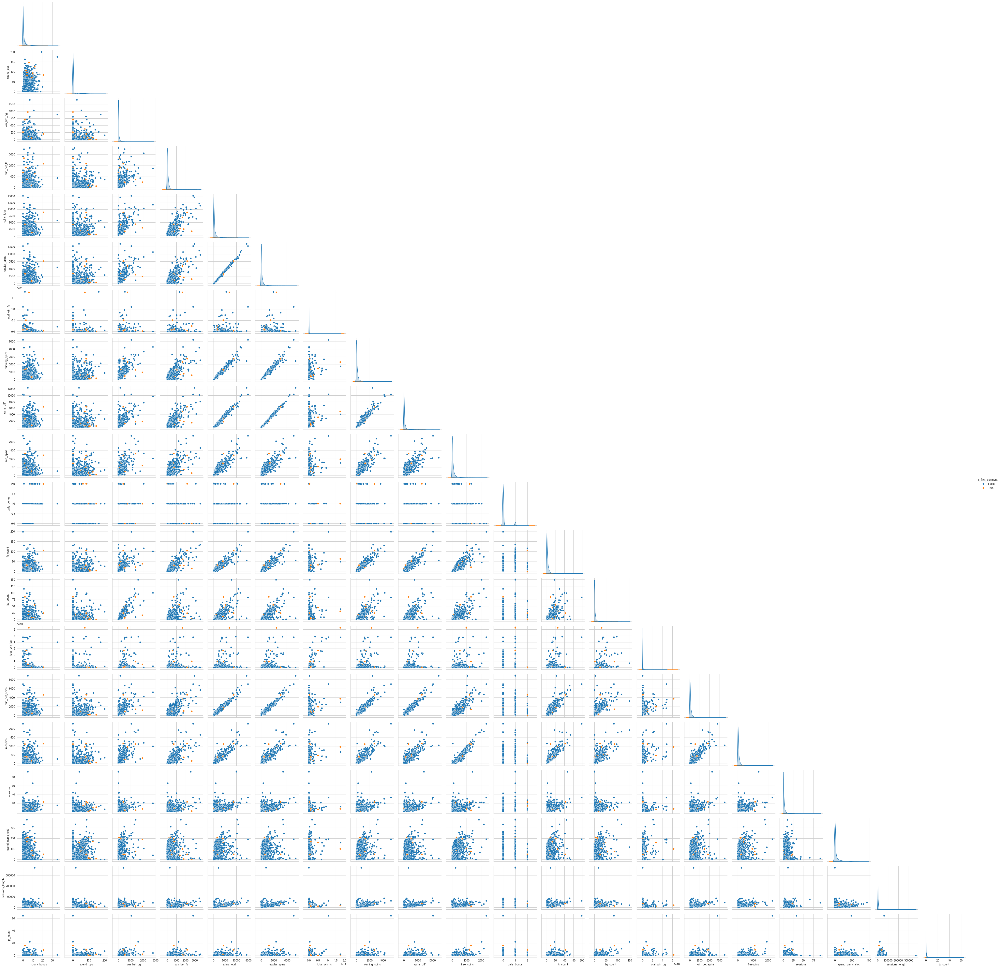

In [20]:
sns.pairplot(
    df_pandas[top_features + ["is_first_payment"]], hue="is_first_payment", corner=True
)

In [21]:
def get_outliers(
    data: pd.DataFrame, quantile: float = 0.95, columns: list[str] | None = None
) -> pd.Index:
    """
    Get indices of rows where at least one specified column exceeds its chosen quantile.

    Parameters
    ----------
    data : pd.DataFrame
        The original DataFrame.
    quantile : float
        Quantile value to find above outliers.
    columns : list of str, optional
        Columns for which we check the chosen quantile cutoff.
        If None, all numeric columns are used.

    Returns
    -------
    pd.Index
        The index labels of rows that exceed the chosen quantile
        in at least one column.
    """

    if columns is None:
        columns = data.select_dtypes(include=["number"]).columns.tolist()

    quantiles = data[columns].quantile(quantile)
    mask_exceeds_95 = (data[columns] > quantiles).any(axis=1)
    return data[mask_exceeds_95].index

In [22]:
df_pandas.shape

(10000, 49)

In [23]:
df_pandas = df.select(pl.all().exclude(to_exclude)).to_pandas()

In [24]:
outliers_indices = get_outliers(df_pandas, quantile=0.99)

In [25]:
outliers_id = (
    df.with_row_index()
    .filter(pl.col("index").is_in(outliers_indices))
    .select("progress_id")
    .unique()
)

In [26]:
df = df.filter(~pl.col("progress_id").is_in(outliers_id))

In [27]:
df.shape

(128496, 53)

In [28]:
df_pandas = df.select(pl.all().exclude(to_exclude)).to_pandas().sample(10000)

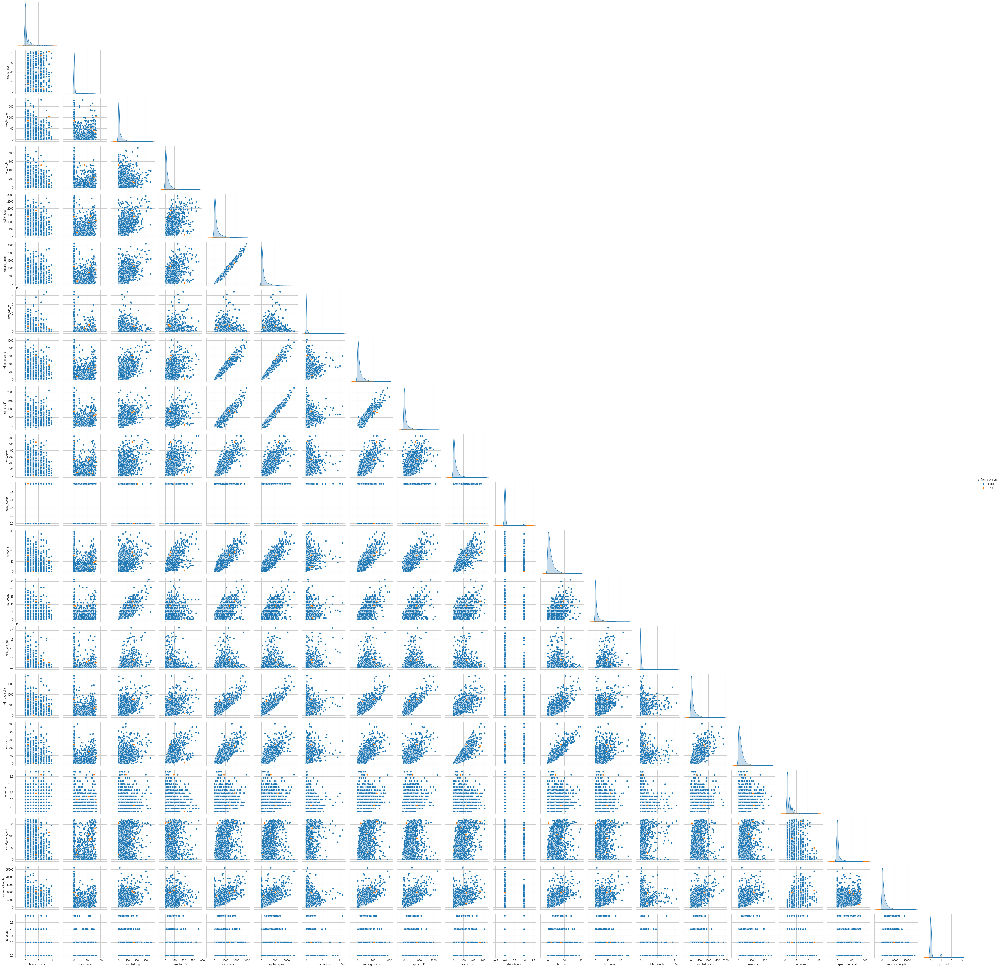

In [29]:
sns.pairplot(
    df_pandas[top_features + ["is_first_payment"]], hue="is_first_payment", corner=True
)

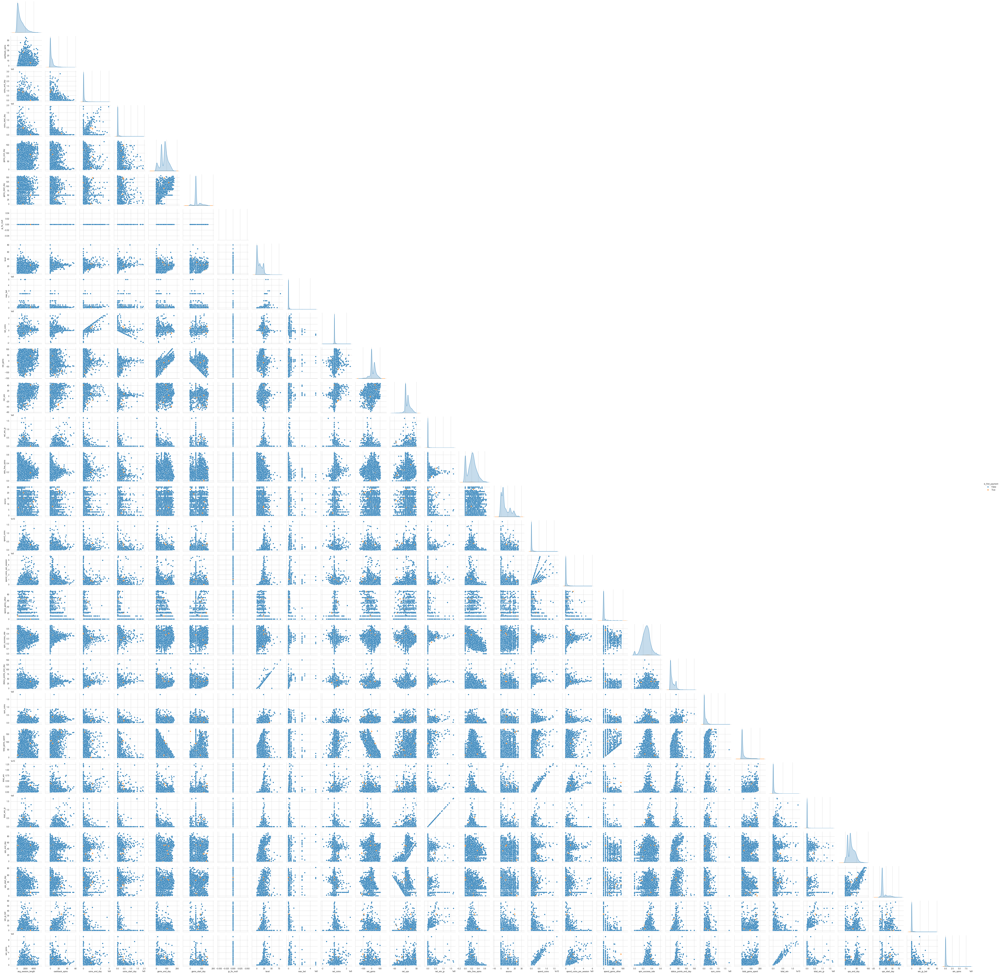

In [30]:
other_features = df_pandas.columns.difference(top_features)
sns.pairplot(
    df_pandas[other_features], hue="is_first_payment", corner=True
)

In [31]:
df = df.drop(["jp_fix_mult"])

Generate new features

In [32]:
cat_features = ["country_install", "source", "daily_bonus", "jp_count", "hourly_bonus"]

In [33]:
df.head()

progress_id,action_date,entry_date,sessions,sessions_length,level,spins_total,regular_spins,free_spins,coins_start_day,coins_end_day,spend_coins,gems_start_day,gems_end_day,spend_gems_slot,spend_gems_other,ups_start_day,ups_end_day,spend_ups,hourly_bonus,daily_bonus,status_points_end_day,country_install,source,total_win_bg,total_win_fs,total_win,max_bet,total_win_jp,cashback_spins,win_jp_bet,win_spins,win_bet_spins,win_bet_bg,win_bet_fs,winning_spins,jp_count,bg_count,fs_count,freespins,sum_coins,is_first_payment,avg_session_length,ratio_free_spins,net_coins,total_gems_spent,net_gems,net_ups,net_win_jp,spin_success_rate,spins_diff,spend_coins_per_session
str,"datetime[μs, UTC]","datetime[μs, UTC]",i64,i64,i64,i64,i64,i64,f64,f64,f64,i64,i64,i64,i64,i64,i64,i64,i64,i64,i64,str,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,i64,i64,i64,i64,i64,bool,f64,f64,f64,i64,i64,i64,f64,f64,i64,f64
"""027641e85c7431b7841070fb5c0""",2023-03-27 00:00:00 UTC,2023-03-25 00:00:00 UTC,13,22641,43,3108,2696,412,2.18107e8,43851.0,1.0688e10,64,0,146,0,39,0,81,4,0,76,"""US""",8,7.8463e8,7.51425e8,8.5645e9,8e7,0.0,5.61,0.0,7.0284e9,1347.05,404.6,325.845,1010,0,26,19,203,92730851,false,1741.615385,0.132561,-2.1806e8,146,-64,-39,0.0,0.324968,2284,8.2216e8
"""8366419c8ababee80c077087ffc""",2023-03-21 00:00:00 UTC,2023-03-21 00:00:00 UTC,9,16249,23,2501,2151,350,1.2e7,24000.0,1.2102e9,50,137,14,0,10,43,0,0,0,36,"""DK""",13,1.516e8,2.28069e8,1.1315e9,5e6,0.0,0.0,0.0,7.51809e8,1415.48,336.0,389.055,869,0,26,27,295,11500000,false,1805.444444,0.139944,-1.1976e7,14,87,33,0.0,0.347461,1801,1.3447e8
"""882642560e1cb8cced4bc071fba""",2023-03-30 00:00:00 UTC,2023-03-30 00:00:00 UTC,6,11896,27,1567,1372,195,1.2e7,1.0502e9,5.3413e9,50,88,90,0,10,51,0,0,0,44,"""NL""",13,1.1688e9,1.3756e9,5.7268e9,5e6,0.0,0.0,0.0,3.1823e9,877.46,404.0,315.365,549,0,26,15,140,26500000,false,1982.666667,0.124442,1.0382e9,90,38,41,0.0,0.350351,1177,8.9022e8
"""1316425a7f80831be6a02003b65""",2023-03-30 00:00:00 UTC,2023-03-30 00:00:00 UTC,3,15532,26,2169,1592,577,1.2e7,2.9764233e7,4.2975e9,50,1,70,90,10,48,0,8,0,42,"""US""",13,8.4025e8,8.21043e8,4.0582e9,2.5e7,0.0,30.6,0.0,2.3970e9,953.215,393.0,409.76,702,0,26,24,492,22311233,true,5177.333333,0.266021,1.7764233e7,160,-49,38,0.0,0.323651,1015,1.4325e9
"""79664207442212a2c3c9307f362""",2023-03-30 00:00:00 UTC,2023-03-26 00:00:00 UTC,4,12355,44,2121,1793,328,76491.0,4.4065664e7,8.2132e9,90,53,105,0,50,73,0,2,0,78,"""ID""",12,1.1786e9,1.9306e9,6.1155e9,5e7,3.45725e7,34.8,23.188115,2.9717e9,667.36,310.669987,567.645,661,2,26,23,203,82016090,false,3088.75,0.154644,4.3989173e7,105,-37,23,3.4572e7,0.311645,1465,2.0533e9


In [34]:
df.shape

(128496, 52)

In [35]:
# Exclude specific columns
to_exclude = [
    "action_date",
    "entry_date",
    "progress_id",
    "is_first_payment"
]

to_exclude.extend(cat_features)

# Group by 'progress_id' and aggregate multiple statistics
# Aggregation operations with suffixes
aggregations = [
    ("_mean", lambda col: pl.col(col).mean()),
    ("_median", lambda col: pl.col(col).median()),
    ("_std", lambda col: pl.col(col).std()),
    ("_max", lambda col: pl.col(col).max()),
    ("_min", lambda col: pl.col(col).min()),
    ("_sum", lambda col: pl.col(col).sum()),
]

# Apply groupby and dynamic aggregations
df_agg = df.group_by("progress_id").agg(
    [
        agg_func(col).alias(f"{col}{suffix}")
        for suffix, agg_func in aggregations
        for col in df.columns
        if col not in to_exclude
    ]
)

In [36]:
df_agg.head()

progress_id,sessions_mean,sessions_length_mean,level_mean,spins_total_mean,regular_spins_mean,free_spins_mean,coins_start_day_mean,coins_end_day_mean,spend_coins_mean,gems_start_day_mean,gems_end_day_mean,spend_gems_slot_mean,spend_gems_other_mean,ups_start_day_mean,ups_end_day_mean,spend_ups_mean,status_points_end_day_mean,total_win_bg_mean,total_win_fs_mean,total_win_mean,max_bet_mean,total_win_jp_mean,cashback_spins_mean,win_jp_bet_mean,win_spins_mean,win_bet_spins_mean,win_bet_bg_mean,win_bet_fs_mean,winning_spins_mean,bg_count_mean,fs_count_mean,freespins_mean,sum_coins_mean,avg_session_length_mean,ratio_free_spins_mean,net_coins_mean,…,coins_start_day_sum,coins_end_day_sum,spend_coins_sum,gems_start_day_sum,gems_end_day_sum,spend_gems_slot_sum,spend_gems_other_sum,ups_start_day_sum,ups_end_day_sum,spend_ups_sum,status_points_end_day_sum,total_win_bg_sum,total_win_fs_sum,total_win_sum,max_bet_sum,total_win_jp_sum,cashback_spins_sum,win_jp_bet_sum,win_spins_sum,win_bet_spins_sum,win_bet_bg_sum,win_bet_fs_sum,winning_spins_sum,bg_count_sum,fs_count_sum,freespins_sum,sum_coins_sum,avg_session_length_sum,ratio_free_spins_sum,net_coins_sum,total_gems_spent_sum,net_gems_sum,net_ups_sum,net_win_jp_sum,spin_success_rate_sum,spins_diff_sum,spend_coins_per_session_sum
str,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,…,f64,f64,f64,i64,i64,i64,i64,i64,i64,i64,i64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,f64,i64,i64,i64,i64,i64,f64,f64,f64,i64,i64,i64,f64,f64,i64,f64
"""4926428c3abe4a5ffc1d90f5b1b""",1.0,466.0,3.0,80.0,70.0,10.0,1.2e7,1.3548e7,5.76e6,50.0,86.0,0.0,0.0,10.0,22.0,0.0,3.0,0.0,1.174e6,3.808e6,200000.0,0.0,0.0,0.0,2.634e6,39.475,0.0,14.675,15.0,0.0,1.0,10.0,300000.0,466.0,0.125,1.548e6,…,1.2e7,1.3548e7,5.76e6,50,86,0,0,10,22,0,3,0.0,1.174e6,3.808e6,200000.0,0.0,0.0,0.0,2.634e6,39.475,0.0,14.675,15,0,1,10,300000,466.0,0.125,1.548e6,0,36,12,0.0,0.1875,60,5.76e6
"""8256416ae1ffbe8b8199d060b14""",2.0,3171.0,23.5,748.5,563.5,185.0,2.8653e7,1.00471393e8,5.66575e8,74.5,73.0,70.5,0.0,9.0,13.0,31.0,37.0,6.6e7,8.31125e7,4.30752e8,1.125e7,0.0,11.075,0.0,2.816395e8,249.4225,37.5,56.48,224.0,3.5,9.0,80.0,1.7816e7,1795.666667,0.24859,7.1818e7,…,5.7306393e7,2.00942786e8,1.1332e9,149,146,141,0,18,26,62,74,1.32e8,1.66225e8,8.61504e8,2.25e7,0.0,22.15,0.0,5.63279e8,498.845,75.0,112.96,448,7,18,160,35632393,3591.333333,0.497181,1.43636393e8,141,-3,8,0.0,0.597705,757,8.6438e8
"""172641c520f93198121020ea646""",2.0,1495.0,12.0,272.0,199.0,73.0,1.2e7,4.3798506e7,1.0175e8,50.0,118.0,0.0,0.0,10.0,32.0,0.0,14.0,5e6,4.3209e7,1.15498e8,1e6,250000.0,5.45,1.0,6.7039e7,154.835,10.0,85.84,90.0,1.0,7.0,73.0,7.810506e6,747.5,0.268382,3.1798506e7,…,1.2e7,4.3798506e7,1.0175e8,50,118,0,0,10,32,0,14,5e6,4.3209e7,1.15498e8,1e6,250000.0,5.45,1.0,6.7039e7,154.835,10.0,85.84,90,1,7,73,7810506,747.5,0.268382,3.1798506e7,0,68,22,249999.0,0.330882,126,5.0875e7
"""4336425c9c9610ee5fcc203eb9a""",1.0,335.0,1.0,81.0,35.0,46.0,1.2e7,1.5611e7,1.6e6,50.0,80.0,0.0,0.0,10.0,20.0,0.0,1.0,0.0,2.85e6,5.111e6,80000.0,0.0,0.0,0.0,2.261e6,55.275,0.0,37.4,12.0,0.0,4.0,46.0,100000.0,335.0,0.567901,3.611e6,…,1.2e7,1.5611e7,1.6e6,50,80,0,0,10,20,0,1,0.0,2.85e6,5.111e6,80000.0,0.0,0.0,0.0,2.261e6,55.275,0.0,37.4,12,0,4,46,100000,335.0,0.567901,3.611e6,0,30,10,0.0,0.148148,-11,1.6e6
"""9746427044935ab82bec40061b2""",2.0,504.0,2.0,69.0,49.0,20.0,1.2e7,1.4014e7,3.8e6,50.0,83.0,0.0,0.0,10.0,21.0,0.0,2.0,0.0,2.018e6,3.814e6,200000.0,0.0,0.0,0.0,1.796e6,32.725,0.0,25.225,9.0,0.0,2.0,20.0,200000.0,252.0,0.289855,2.014e6,…,1.2e7,1.4014e7,3.8e6,50,83,0,0,10,21,0,2,0.0,2.018e6,3.814e6,200000.0,0.0,0.0,0.0,1.796e6,32.725,0.0,25.225,9,0,2,20,200000,252.0,0.289855,2.014e6,0,33,11,0.0,0.130435,29,1.9e6


In [37]:
is_first_payment_df = df.group_by("progress_id").agg(
    pl.col("is_first_payment").any().alias("is_first_payment")
)

cat_features_df = df.group_by("progress_id").agg(pl.col(cat_features).mode().first())

In [38]:
df_agg = df_agg.join(is_first_payment_df, on="progress_id")
df_agg = df_agg.join(cat_features_df, on="progress_id")

In [39]:
missing_df = (
    df_agg.null_count()
    .transpose(include_header=True)
    .rename({"column_0": "Null Values"})
    .with_columns((pl.col("Null Values") / df.shape[0] * 100).alias("Null%"))
    .sort("Null Values", descending=True)
)

missing_df

column,Null Values,Null%
str,u32,f64
"""total_win_bg_std""",66182,51.505105
"""total_win_fs_std""",66182,51.505105
"""total_win_std""",66182,51.505105
"""max_bet_std""",66182,51.505105
"""total_win_jp_std""",66182,51.505105
…,…,…
"""spend_coins_per_session_sum""",0,0.0
"""is_first_payment""",0,0.0
"""source""",0,0.0


In [40]:
df_agg = df_agg.with_columns(
    (pl.col("is_first_payment").cast(pl.Int8)).alias("is_first_payment")
)

Imbalanced classification problem

In [41]:
df_agg.group_by("is_first_payment").len()

is_first_payment,len
i8,u32
1,320
0,85427


Split data

In [42]:
to_exclude = [
    "progress_id",
    "action_date",
    "entry_date",
    "is_first_payment",
]

to_exclude.extend(cat_features)
X = df_agg.select(pl.all().exclude(to_exclude)).to_pandas()

In [43]:
X = X.replace([np.inf, -np.inf], np.nan)
X = X.dropna(axis=1, how="all")
y = df_agg.select("is_first_payment").to_pandas()

In [136]:
X_train, X_val, X_test, y_train, y_val, y_test = split_data(
    X, y, val_size=0.1, test_size=0.2, use_stratification=True, random_state=42
)

In [137]:
imputer = SimpleImputer(strategy="median")
X_train = pd.DataFrame(imputer.fit_transform(X_train), columns=X_train.columns)

In [138]:
X_val = X_val.replace([np.inf, -np.inf], np.nan)
X_val = pd.DataFrame(imputer.transform(X_val), columns=X_val.columns)

X_test = X_test.replace([np.inf, -np.inf], np.nan)
X_test = pd.DataFrame(imputer.transform(X_test), columns=X_test.columns)

In [139]:
X_train_full = pd.concat([X_train, X_val], axis=0)
y_train_full = pd.concat([y_train, y_val], axis=0)

In [140]:
X_train.stb.missing()

,missing,total,percent
sessions_mean,0,60022,0.0
total_win_jp_min,0,60022,0.0
ratio_free_spins_max,0,60022,0.0
net_coins_max,0,60022,0.0
total_gems_spent_max,0,60022,0.0
...,...,...,...
free_spins_std,0,60022,0.0
coins_start_day_std,0,60022,0.0
coins_end_day_std,0,60022,0.0
spend_coins_std,0,60022,0.0


In [141]:
X_val.stb.missing()

,missing,total,percent
sessions_mean,0,8575,0.0
total_win_jp_min,0,8575,0.0
ratio_free_spins_max,0,8575,0.0
net_coins_max,0,8575,0.0
total_gems_spent_max,0,8575,0.0
...,...,...,...
free_spins_std,0,8575,0.0
coins_start_day_std,0,8575,0.0
coins_end_day_std,0,8575,0.0
spend_coins_std,0,8575,0.0


In [142]:
X_test.stb.missing()

,missing,total,percent
sessions_mean,0,17150,0.0
total_win_jp_min,0,17150,0.0
ratio_free_spins_max,0,17150,0.0
net_coins_max,0,17150,0.0
total_gems_spent_max,0,17150,0.0
...,...,...,...
free_spins_std,0,17150,0.0
coins_start_day_std,0,17150,0.0
coins_end_day_std,0,17150,0.0
spend_coins_std,0,17150,0.0


In [143]:
y_train.stb.freq(["is_first_payment"])

,is_first_payment,count,percent,cumulative_count,cumulative_percent
0,0,59798,99.626804,59798,99.626804
1,1,224,0.373196,60022,100.000000


In [144]:
y_val.stb.freq(["is_first_payment"])

,is_first_payment,count,percent,cumulative_count,cumulative_percent
0,0,8543,99.626822,8543,99.626822
1,1,32,0.373178,8575,100.000000


In [145]:
y_test.stb.freq(["is_first_payment"])

,is_first_payment,count,percent,cumulative_count,cumulative_percent
0,0,17086,99.626822,17086,99.626822
1,1,64,0.373178,17150,100.000000


Hyperparameter tuning

In [54]:
def optimize_catboost(
    X: pd.DataFrame,
    y: pd.Series,
    n_splits: int = 5,
    n_repeats: int = 3,
    n_trials: int = 50,
    random_state: int = 42,
    max_iterations: int = 1000,
    optimize_metric: Literal["F1", "Recall"] = "F1",
) -> Tuple[optuna.Study, Dict[str, Any], pd.DataFrame]:
    """
    Optimize CatBoost hyperparameters for imbalanced classification using SMOTEENN
    and RepeatedStratifiedKFold, measuring either the Recall or the F1-score for
    the positive class (class 1). Then, with the best hyperparameters found, run
    a custom cross-validation to collect iteration-wise metrics (F1/Recall + Logloss)
    across folds, returning a table similar to catboost.cv output.

    Parameters
    ----------
    X : pd.DataFrame
        The feature matrix.
    y : pd.Series
        The target vector with imbalanced classes (binary, with 0 and 1).
    n_splits : int, optional
        Number of folds for Stratified K-Fold, by default 5.
    n_repeats : int, optional
        Number of repetitions for RepeatedStratifiedKFold, by default 3.
    n_trials : int, optional
        Number of trials for the Optuna study, by default 50.
    random_state : int, optional
        Random seed for reproducibility, by default 42.
    max_iterations : int, optional
        The maximum number of boosting iterations to use (like in catboost.cv),
        by default 1000.
    optimize_metric : {"F1", "Recall"}, optional
        Which metric to optimize for class 1, by default "F1".

    Returns
    -------
    Tuple[optuna.Study, Dict[str, Any], pd.DataFrame]
        A tuple containing:
        - study : optuna.Study
            The Optuna study object after completion of trials.
        - best_params : Dict[str, Any]
            The best set of hyperparameters found.
        - cv_results : pd.DataFrame
            A DataFrame containing iteration-wise means and standard deviations
            for training/validation metrics (F1 or Recall, and Logloss), aggregated
            over all folds. Columns are similar to catboost.cv output.
    """
    import warnings

    warnings.filterwarnings("ignore", category=UserWarning)

    # Decide which metric is the "main" one for CatBoost and for our manual scoring
    if optimize_metric not in ["F1", "Recall"]:
        raise ValueError("optimize_metric must be either 'F1' or 'Recall'.")

    # 1) Define the Optuna objective function using cross-validation
    def objective(trial: optuna.Trial) -> float:
        """
        Returns mean chosen_metric (pos_label=1) over all folds (to be maximized).
        """
        # CatBoost will watch 'eval_metric' for each iteration
        params = {
            "loss_function": "Logloss",
            "eval_metric": optimize_metric,  # Evaluate "F1" or "Recall" on validation
            "custom_metric": ["Logloss"],
            "iterations": max_iterations,
            "use_best_model": False,  # do not stop early
            "metric_period": 1,  # log metric at every iteration
            "depth": trial.suggest_int("depth", 3, 12),
            "learning_rate": trial.suggest_float("learning_rate", 1e-4, 0.3, log=True),
            "l2_leaf_reg": trial.suggest_int("l2_leaf_reg", 1, 100, log=True),
            "random_strength": trial.suggest_float(
                "random_strength", 1e-2, 10.0, log=True
            ),
            "border_count": trial.suggest_int("border_count", 32, 256),
            "scale_pos_weight": trial.suggest_int("scale_pos_weight", 1, 100, log=True),
            "verbose": 0,
            "random_seed": random_state,
            "allow_writing_files": False
        }

        # We'll pick the appropriate scoring function for the fold evaluation
        if optimize_metric == "Recall":
            scoring_func = lambda y_true, y_pred: recall_score(
                y_true, y_pred, pos_label=1
            )
        else:
            scoring_func = lambda y_true, y_pred: f1_score(y_true, y_pred, pos_label=1)

        rskf = RepeatedStratifiedKFold(
            n_splits=n_splits, n_repeats=n_repeats, random_state=random_state
        )

        fold_scores = []
        for train_index, val_index in rskf.split(X, y):
            X_train, X_val = X.iloc[train_index], X.iloc[val_index]
            y_train, y_val = y.iloc[train_index], y.iloc[val_index]

            # Apply SMOTEENN on training fold
            sampler = SMOTEENN(random_state=random_state)
            X_resampled, y_resampled = sampler.fit_resample(X_train, y_train)

            # Train
            model = CatBoostClassifier(**params)
            model.fit(X_resampled, y_resampled, eval_set=(X_val, y_val))

            # Predict on validation fold
            y_pred = model.predict(X_val)

            # Compute chosen metric for class 1
            fold_scores.append(scoring_func(y_val, y_pred))

        return float(np.mean(fold_scores))

    # 2) Run Optuna study
    study = optuna.create_study(direction="maximize")
    study.optimize(objective, n_trials=n_trials, show_progress_bar=False)

    best_params = study.best_trial.params

    # Merge fixed params back in
    fixed_params = {
        "loss_function": "Logloss",
        "eval_metric": optimize_metric,  # same as chosen above
        "custom_metric": ["Logloss"],
        "iterations": max_iterations,
        "use_best_model": False,
        "metric_period": 1,
        "verbose": 0,
        "random_seed": random_state,
        "allow_writing_files": False,
    }
    for k, v in fixed_params.items():
        best_params[k] = v

    # 3) Final cross-validation pass to gather iteration-wise metrics
    def cross_val_iterations(
        X: pd.DataFrame,
        y: pd.Series,
        params: Dict[str, Any],
        n_splits: int,
        n_repeats: int,
        random_state: int,
        main_metric: str,
    ) -> pd.DataFrame:
        """
        Run repeated CV for a fixed set of CatBoost parameters, capturing
        iteration-wise metrics (F1/Recall + Logloss) for each fold, then averaging.

        Returns a DataFrame with columns similar to catboost.cv:
            iteration,
            train-{main_metric}-mean, train-{main_metric}-std,
            test-{main_metric}-mean,  test-{main_metric}-std,
            train-Logloss-mean,       train-Logloss-std,
            test-Logloss-mean,        test-Logloss-std
        """
        rskf = RepeatedStratifiedKFold(
            n_splits=n_splits, n_repeats=n_repeats, random_state=random_state
        )

        train_metric_folds = []
        test_metric_folds = []
        train_logloss_folds = []
        test_logloss_folds = []

        for train_index, val_index in rskf.split(X, y):
            X_train, X_val = X.iloc[train_index], X.iloc[val_index]
            y_train, y_val = y.iloc[train_index], y.iloc[val_index]

            sampler = SMOTEENN(random_state=random_state)
            X_resampled, y_resampled = sampler.fit_resample(X_train, y_train)

            model = CatBoostClassifier(**params)
            model.fit(X_resampled, y_resampled, eval_set=(X_val, y_val))

            results = model.get_evals_result()
            train_key, test_key = "learn", "validation"
            if test_key not in results:
                # older catboost versions might store "eval"
                test_key = "eval"

            # The main metric might be "F1" or "Recall", custom metric is "Logloss"
            # Example: results["learn"]["F1"] or results["learn"]["Recall"]
            train_metric_folds.append(results[train_key][main_metric])
            test_metric_folds.append(results[test_key][main_metric])

            # If "Logloss" not found, fallback to "TotalLoss"
            if "Logloss" in results[train_key]:
                train_logloss_folds.append(results[train_key]["Logloss"])
                test_logloss_folds.append(results[test_key]["Logloss"])
            else:
                train_logloss_folds.append(results[train_key]["TotalLoss"])
                test_logloss_folds.append(results[test_key]["TotalLoss"])

        # Convert to arrays of shape (num_folds, num_iterations)
        train_metric_folds = np.array(train_metric_folds, dtype=object)
        test_metric_folds = np.array(test_metric_folds, dtype=object)
        train_logloss_folds = np.array(train_logloss_folds, dtype=object)
        test_logloss_folds = np.array(test_logloss_folds, dtype=object)

        n_iters = len(train_metric_folds[0])  # should match 'iterations'

        data = []
        for i in range(n_iters):
            # Gather iteration i across all folds
            train_metric_values = [fold[i] for fold in train_metric_folds]
            test_metric_values = [fold[i] for fold in test_metric_folds]
            train_logloss_values = [fold[i] for fold in train_logloss_folds]
            test_logloss_values = [fold[i] for fold in test_logloss_folds]

            data.append(
                {
                    "iteration": i + 1,  # 1-based
                    f"train-{main_metric}-mean": np.mean(train_metric_values),
                    f"train-{main_metric}-std": np.std(train_metric_values, ddof=1),
                    f"test-{main_metric}-mean": np.mean(test_metric_values),
                    f"test-{main_metric}-std": np.std(test_metric_values, ddof=1),
                    "train-Logloss-mean": np.mean(train_logloss_values),
                    "train-Logloss-std": np.std(train_logloss_values, ddof=1),
                    "test-Logloss-mean": np.mean(test_logloss_values),
                    "test-Logloss-std": np.std(test_logloss_values, ddof=1),
                }
            )

        return pd.DataFrame(data)

    cv_results = cross_val_iterations(
        X, y, best_params, n_splits, n_repeats, random_state, optimize_metric
    )

    return study, best_params, cv_results

In [55]:
# Optimize and retrieve iteration-wise CV results
study_obj, best_params, cv_table = optimize_catboost(
    X_train_full,
    y_train_full,
    optimize_metric="F1",
    n_splits=3,
    n_repeats=3,
    n_trials=20,
    random_state=42,
    max_iterations=5000,
)

[I 2025-01-21 22:00:57,049] A new study created in memory with name: no-name-8538d803-97a4-46e4-881f-115f2b0a5ddc
[I 2025-01-21 22:13:51,681] Trial 0 finished with value: 0.008536811980182225 and parameters: {'depth': 3, 'learning_rate': 0.0038158580397982082, 'l2_leaf_reg': 10, 'random_strength': 1.9478512303864286, 'border_count': 222, 'scale_pos_weight': 31}. Best is trial 0 with value: 0.008536811980182225.
[I 2025-01-21 22:41:22,909] Trial 1 finished with value: 0.002178469127512418 and parameters: {'depth': 8, 'learning_rate': 0.19546508514333932, 'l2_leaf_reg': 1, 'random_strength': 0.20838820927655652, 'border_count': 240, 'scale_pos_weight': 1}. Best is trial 0 with value: 0.008536811980182225.
[I 2025-01-21 22:55:34,407] Trial 2 finished with value: 0.00357684654504495 and parameters: {'depth': 5, 'learning_rate': 0.005714605745735663, 'l2_leaf_reg': 19, 'random_strength': 3.720091930912661, 'border_count': 78, 'scale_pos_weight': 1}. Best is trial 0 with value: 0.00853681198

In [56]:
cv_table

,iteration,train-F1-mean,train-F1-std,test-F1-mean,test-F1-std,train-Logloss-mean,train-Logloss-std,test-Logloss-mean,test-Logloss-std
0,1,0.851954,0.014762,0.020144,0.004112,0.692429,0.000070,0.692585,0.000056
1,2,0.874786,0.012143,0.023133,0.003216,0.691714,0.000140,0.692028,0.000107
2,3,0.880311,0.010121,0.023629,0.003354,0.691006,0.000166,0.691470,0.000149
3,4,0.885091,0.010646,0.024160,0.002362,0.690363,0.000200,0.690965,0.000151
4,5,0.885989,0.014597,0.024780,0.001834,0.689628,0.000251,0.690395,0.000206
...,...,...,...,...,...,...,...,...,...
4995,4996,0.972997,0.003078,0.016391,0.008598,0.148345,0.007828,0.221626,0.014777
4996,4997,0.973003,0.003075,0.016390,0.008598,0.148331,0.007828,0.221621,0.014781
4997,4998,0.973002,0.003078,0.016390,0.008598,0.148309,0.007830,0.221599,0.014781
4998,4999,0.973009,0.003079,0.016391,0.008597,0.148290,0.007828,0.221588,0.014773


In [121]:
# Print results
print("Best F1:", study_obj.best_value)

best_params["iterations"] = cv_table["test-F1-mean"].idxmax()
print("Best parameters:", best_params)

Best F1: 0.0163908554988851
Best parameters: {'depth': 10, 'learning_rate': 0.0007455747859363014, 'l2_leaf_reg': 50, 'random_strength': 1.3429656678038102, 'border_count': 203, 'scale_pos_weight': 1, 'loss_function': 'Logloss', 'eval_metric': 'F1', 'custom_metric': ['Logloss'], 'iterations': 1092, 'use_best_model': False, 'metric_period': 1, 'verbose': 0, 'random_seed': 42, 'allow_writing_files': False}


In [128]:
model = Pipeline(
    [
        (
            "smoteenn",
            SMOTEENN(random_state=42),
        ),
        (
            "catboost",
            CatBoostClassifier(
                loss_function="Logloss",
                iterations=best_params["iterations"],
                depth=best_params["depth"],
                learning_rate=best_params["learning_rate"],
                l2_leaf_reg=best_params["l2_leaf_reg"],
                random_strength=best_params["random_strength"],
                border_count=best_params["border_count"],
                scale_pos_weight=best_params["scale_pos_weight"],
                random_seed=42,
            ),
        ),
    ]
)

In [129]:
model.fit(X_train_full, y_train_full)

0:	learn: 0.6924618	total: 117ms	remaining: 2m 7s
1:	learn: 0.6916467	total: 229ms	remaining: 2m 4s
2:	learn: 0.6909748	total: 347ms	remaining: 2m 5s
3:	learn: 0.6903085	total: 470ms	remaining: 2m 7s
4:	learn: 0.6896261	total: 591ms	remaining: 2m 8s
5:	learn: 0.6889037	total: 705ms	remaining: 2m 7s
6:	learn: 0.6881786	total: 821ms	remaining: 2m 7s
7:	learn: 0.6874042	total: 936ms	remaining: 2m 6s
8:	learn: 0.6867038	total: 1.06s	remaining: 2m 7s
9:	learn: 0.6860085	total: 1.17s	remaining: 2m 6s
10:	learn: 0.6853119	total: 1.28s	remaining: 2m 6s
11:	learn: 0.6848418	total: 1.4s	remaining: 2m 6s
12:	learn: 0.6841922	total: 1.52s	remaining: 2m 6s
13:	learn: 0.6835013	total: 1.64s	remaining: 2m 6s
14:	learn: 0.6827788	total: 1.76s	remaining: 2m 6s
15:	learn: 0.6821191	total: 1.88s	remaining: 2m 6s
16:	learn: 0.6814228	total: 1.99s	remaining: 2m 5s
17:	learn: 0.6806872	total: 2.1s	remaining: 2m 5s
18:	learn: 0.6800088	total: 2.22s	remaining: 2m 5s
19:	learn: 0.6793358	total: 2.33s	remaining

Pipeline(steps=[('smoteenn', SMOTEENN(random_state=42)),
                ('catboost',
                 <catboost.core.CatBoostClassifier object at 0x3d8985060>)])

In [171]:
pred = model.predict(X_test)
pred_proba = model.predict_proba(X_test)[:, 1]

In [172]:
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       1.00      0.93      0.96     17086
           1       0.01      0.27      0.03        64

    accuracy                           0.93     17150
   macro avg       0.51      0.60      0.49     17150
weighted avg       0.99      0.93      0.96     17150



In [173]:
confusion_matrix(y_test, pred)

array([[15859,  1227],
       [   47,    17]])

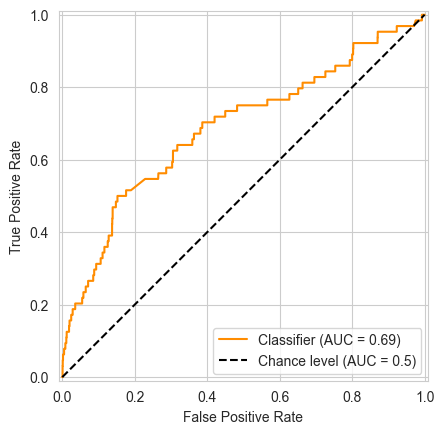

In [174]:
display = RocCurveDisplay.from_predictions(
    y_test,
    pred_proba,
    color="darkorange",
    plot_chance_level=True,
)
_ = display.ax_.set(xlabel="False Positive Rate", ylabel="True Positive Rate")

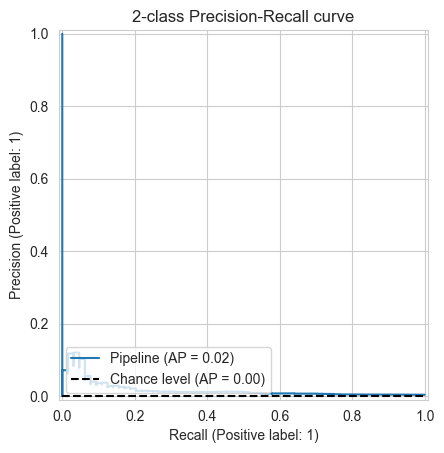

In [175]:
display = PrecisionRecallDisplay.from_estimator(
    model, X_test, y_test, name="Pipeline", plot_chance_level=True
)
_ = display.ax_.set_title("2-class Precision-Recall curve")

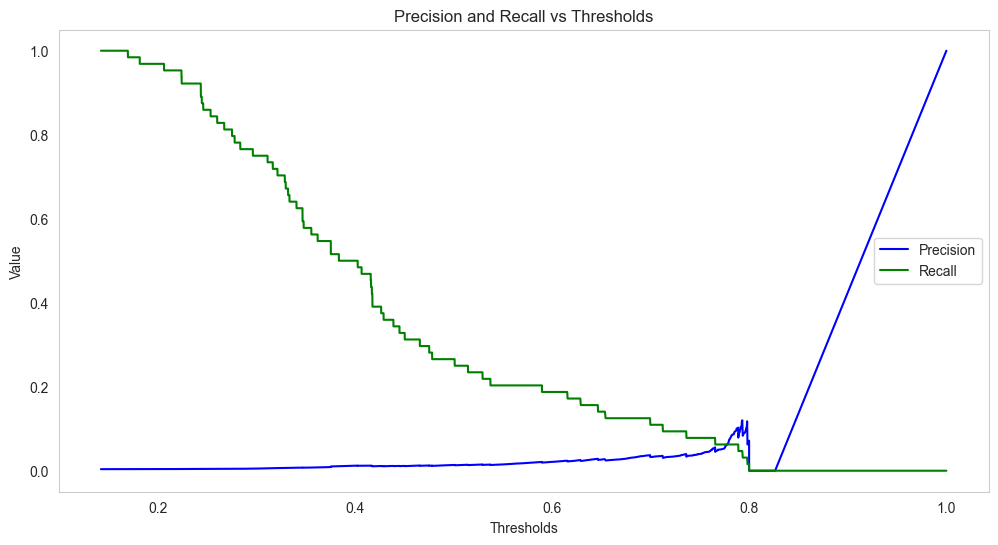

In [176]:
precision, recall, thresholds = precision_recall_curve(y_test, pred_proba)
thresholds = np.append(thresholds, 1.0)

plt.figure(figsize=(12, 6))
plt.plot(thresholds, precision, label="Precision", color="blue")
plt.plot(thresholds, recall, label="Recall", color="green")

plt.xlabel("Thresholds")
plt.ylabel("Value")
plt.title("Precision and Recall vs Thresholds")
plt.legend()
plt.grid()
plt.show()

Fearure selection

In [177]:
model.fit(X_train, y_train)

0:	learn: 0.6924775	total: 135ms	remaining: 2m 26s
1:	learn: 0.6917992	total: 240ms	remaining: 2m 11s
2:	learn: 0.6910628	total: 347ms	remaining: 2m 6s
3:	learn: 0.6903778	total: 458ms	remaining: 2m 4s
4:	learn: 0.6897513	total: 573ms	remaining: 2m 4s
5:	learn: 0.6890059	total: 682ms	remaining: 2m 3s
6:	learn: 0.6882327	total: 789ms	remaining: 2m 2s
7:	learn: 0.6875275	total: 902ms	remaining: 2m 2s
8:	learn: 0.6867371	total: 1.01s	remaining: 2m 1s
9:	learn: 0.6860106	total: 1.11s	remaining: 2m
10:	learn: 0.6852902	total: 1.22s	remaining: 1m 59s
11:	learn: 0.6846177	total: 1.34s	remaining: 2m
12:	learn: 0.6839467	total: 1.45s	remaining: 2m
13:	learn: 0.6832611	total: 1.56s	remaining: 1m 59s
14:	learn: 0.6825622	total: 1.66s	remaining: 1m 59s
15:	learn: 0.6818684	total: 1.77s	remaining: 1m 59s
16:	learn: 0.6811475	total: 1.88s	remaining: 1m 58s
17:	learn: 0.6804570	total: 1.99s	remaining: 1m 58s
18:	learn: 0.6796933	total: 2.09s	remaining: 1m 57s
19:	learn: 0.6789413	total: 2.19s	remaini

Pipeline(steps=[('smoteenn', SMOTEENN(random_state=42)),
                ('catboost',
                 <catboost.core.CatBoostClassifier object at 0x3d8985060>)])

In [178]:
classifier = model.named_steps["catboost"]

In [179]:
feature_importance = classifier.get_feature_importance(
    type="LossFunctionChange", data=Pool(X_val, y_val), prettified=True
)

In [180]:
feature_importance

,Feature Id,Importances
0,sessions_min,0.050109
1,sessions_max,0.044513
2,total_gems_spent_median,0.026298
3,bg_count_sum,0.024343
4,bg_count_max,0.023299
...,...,...
253,total_win_bg_mean,-0.000407
254,total_win_bg_max,-0.000454
255,win_bet_bg_mean,-0.000507
256,total_win_bg_sum,-0.000654


In [198]:
most_importance_features = feature_importance.loc[:50, "Feature Id"]
most_importance_features

0                    sessions_min
1                    sessions_max
2         total_gems_spent_median
3                    bg_count_sum
4                    bg_count_max
5            spend_gems_other_max
6            spend_gems_other_sum
7                   sessions_mean
8                   spend_ups_sum
9                   spend_ups_max
10                 spend_ups_mean
11                   sessions_sum
12                sessions_median
13                   fs_count_max
14            spend_gems_slot_sum
15            coins_start_day_min
16          spend_gems_other_mean
17                win_jp_bet_mean
18            spend_gems_slot_max
19                 win_jp_bet_sum
20             cashback_spins_min
21                 win_jp_bet_max
22           spend_gems_slot_mean
23                   bg_count_min
24           total_gems_spent_max
25          total_gems_spent_mean
26           total_gems_spent_sum
27                   fs_count_min
28                   fs_count_sum
29            

In [199]:
to_drop = X_train.columns.difference(most_importance_features)
X_train_full_filtered = X_train_full.drop(columns=to_drop)
X_test_filtered = X_test.drop(columns=to_drop)

In [200]:
model.fit(X_train_full_filtered, y_train_full)

0:	learn: 0.6924375	total: 42.7ms	remaining: 46.6s
1:	learn: 0.6917212	total: 81.1ms	remaining: 44.2s
2:	learn: 0.6909832	total: 118ms	remaining: 42.9s
3:	learn: 0.6902954	total: 154ms	remaining: 41.9s
4:	learn: 0.6895478	total: 190ms	remaining: 41.3s
5:	learn: 0.6888508	total: 242ms	remaining: 43.9s
6:	learn: 0.6881060	total: 291ms	remaining: 45.1s
7:	learn: 0.6874146	total: 331ms	remaining: 44.9s
8:	learn: 0.6866590	total: 376ms	remaining: 45.2s
9:	learn: 0.6858331	total: 416ms	remaining: 45s
10:	learn: 0.6850807	total: 459ms	remaining: 45.2s
11:	learn: 0.6843063	total: 498ms	remaining: 44.8s
12:	learn: 0.6834811	total: 535ms	remaining: 44.4s
13:	learn: 0.6827266	total: 575ms	remaining: 44.3s
14:	learn: 0.6819953	total: 613ms	remaining: 44s
15:	learn: 0.6813096	total: 652ms	remaining: 43.9s
16:	learn: 0.6806608	total: 694ms	remaining: 43.9s
17:	learn: 0.6799893	total: 735ms	remaining: 43.8s
18:	learn: 0.6792988	total: 774ms	remaining: 43.7s
19:	learn: 0.6786380	total: 815ms	remaining

Pipeline(steps=[('smoteenn', SMOTEENN(random_state=42)),
                ('catboost',
                 <catboost.core.CatBoostClassifier object at 0x3d8985060>)])

In [201]:
pred = model.predict(X_test_filtered)

In [202]:
print(classification_report(y_test, pred))

              precision    recall  f1-score   support

           0       1.00      0.93      0.96     17086
           1       0.01      0.23      0.02        64

    accuracy                           0.92     17150
   macro avg       0.50      0.58      0.49     17150
weighted avg       0.99      0.92      0.96     17150



# Final notes

When our data is imbalanced, we should use techniques such as SMOTEENN or ADASYN. During data analysis, I found that 99.4% of class 0 and 0.56% of class 1 were in this dataset. I tried to use SMOTEENN with different hyperparameters to understand the needed level of oversampling of the minority class, but I chose the "auto" strategy of oversampling according to the quality of the offline metrics.

The next step of the pipeline was the feature selection step. There are simple steps in my pipeline without SHAP analysis; in my experience with SHAP, you cannot get an objective measure of feature importance because, in many cases, SHAP could tell you that the significance of the feature is zero, but when you try to drop this feature you can notice that you metric decrease. This is because many features can be useful in interaction with other features so that permutation importance can be more objective in feature importance estimation.

At the end of the pipeline, I tried calibrating the classifier to get objective class probabilities. However, my calibrated classifier started avoiding class 1 predictions, so I had trouble with this. Therefore, I decided to keep my pipeline as is, without CalibratedClassifierCV. The problem with calibration was imbalanced data, so this step needs further research.

# Some technical notes:
1. I dropped all the categorial features for fast prototyping, because of SMOTEENN.
2. I use RepeatedStratifiedKFold to estimate metrics precisely.
3. Yes, we can use X_val and y_val to stop early during cross-validation, and this score will be overestimated but adequate.
4. I use Catboost because it's convenient for me, and I wanted to experiment with categorical features but I can't use categirical features with SMOTEENN. I used LogisticRegression and other GBDT algorithms. Catboost Is All You Need.
5. I tried to remove outliers by LOF, but instead, I cut outliers after 0.99 quantile.
6. I use statistics from original features such as min, max, mean, median, sum, and std. It looks logical, but maybe it's not the best approach.
7. I use permutation importance to remove useless features. However, in actual cases, I would try different approaches, such as SHAP and permutation importance with confidence intervals. Even VarianceThreshold can be a good feature selector. There are many things for future research.
8. I chose to optimise F1 because the Recall for class 0 decreased to nearly zero after the first iteration in the case I was optimising Recall with Optuna. But it's a good idea to estimate Recall in actual cases.

# About bussiness

1. The "maximize recall first, then pick a threshold" logic works

High recall is critical if your goal is not to miss any potential buyer (class 1). In this case, you can maximize recall for the minor class during the training and hyperparameter fitting phase. Then, once you have a model, you can choose the final decision threshold based on the precision-recall curve to achieve a trade-off between precision and recall.

- Why it works: Since your ultimate goal is to find "as many first-time buyers as possible", you are deliberately sacrificing precision for recall during the training phase. But you can still adjust the decision threshold. If you fixed the threshold too high during training, you might get higher precision but not the recall you need.
- Balance through the threshold: often, companies want not only to "not miss" potential buyers but also not to "spam" users from class 0 too much. The precision-recall curve shows how precision changes with increasing/decreasing recall. By changing the threshold, you choose the optimal point for your business goals.

2. Consider the cost (or "error cost") for each class

To formalize business requirements, it is helpful to quantify what a false positive and false negative mean for you.
- False Negative (FN): this was when the model did not guess class 1 (a user who could have bought, but we did not mark him). For businesses, this may mean lost profit. For example, you could send him an additional offer, a promo code, a letter - and stimulate the purchase.
- False Positive (FP): This is the case when the model mistakenly assigns to class 1 a user who will not make a purchase. If it is expensive for you to contact such users (let's say mailing or SMS mailing is costly), then an FP that is too high may be unprofitable. But if the mailing is cheap and lost sales are expensive, you can probably live with FP.

By formalizing the cost of FN and FP, you can:
- Either choose the optimal classification threshold at which the total "cost" of errors is minimal.
- Or set a condition like "recall not less than 0.9" with the highest possible precision.

3. How to set business requirements in practice

- Determine the threshold of the "pain point" for recall. For example, "Do not miss more than 10% of potential buyers."
- Calculate the costs of False Positive. If FP is cheap (mailing is inexpensive, and lost sales are expensive), you can "afford" more FP. You need to worry about precision if each FP leads to severe costs.
- Consider the income from True Positive. If retaining the majority of potential buyers at any cost is beneficial, you can safely strive for a very high recall, even if the accuracy is low. But if, for example, you have a limited budget for promo, it makes sense to look for the golden mean.-
- Analyze the dynamics beyond one threshold. Sometimes, it is helpful to look at how the model behaves at different recall levels, build graphs and a "cost model". This will give you an understanding of where your ROI (return on investment) will be maximum.

# Non-Smoker Approach
### Uplift-modeling!

It's a big topic, so this [link](https://drive.google.com/file/d/1fw0UIYplPjpP5Fl-4bGQ5mJCx1fnjAqZ/view?usp=sharing) is for you.
